In [83]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
import scipy
#from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.utils import plot_model
from IPython.display import display
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import SGD
#from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, LearningRateScheduler
import os
import PIL
from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False) 

In [64]:
# Check the number of images in training, validation and test dataset

train = [] 
test = []

# os.listdir returns the list of files in the folder, in this case image class names
for i in os.listdir('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train'):
  train_class = os.listdir(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train', i))
  train.extend(train_class)
  test_class = os.listdir(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_test', i))
  test.extend(test_class)

print('Number of train images: {}\nNUmber of test images: {}'.format(len(train),len(test)))

Number of train images: 14034
NUmber of test images: 3000


Number of train images:14034
Number of test images: 3000

# Data exploration and visualization

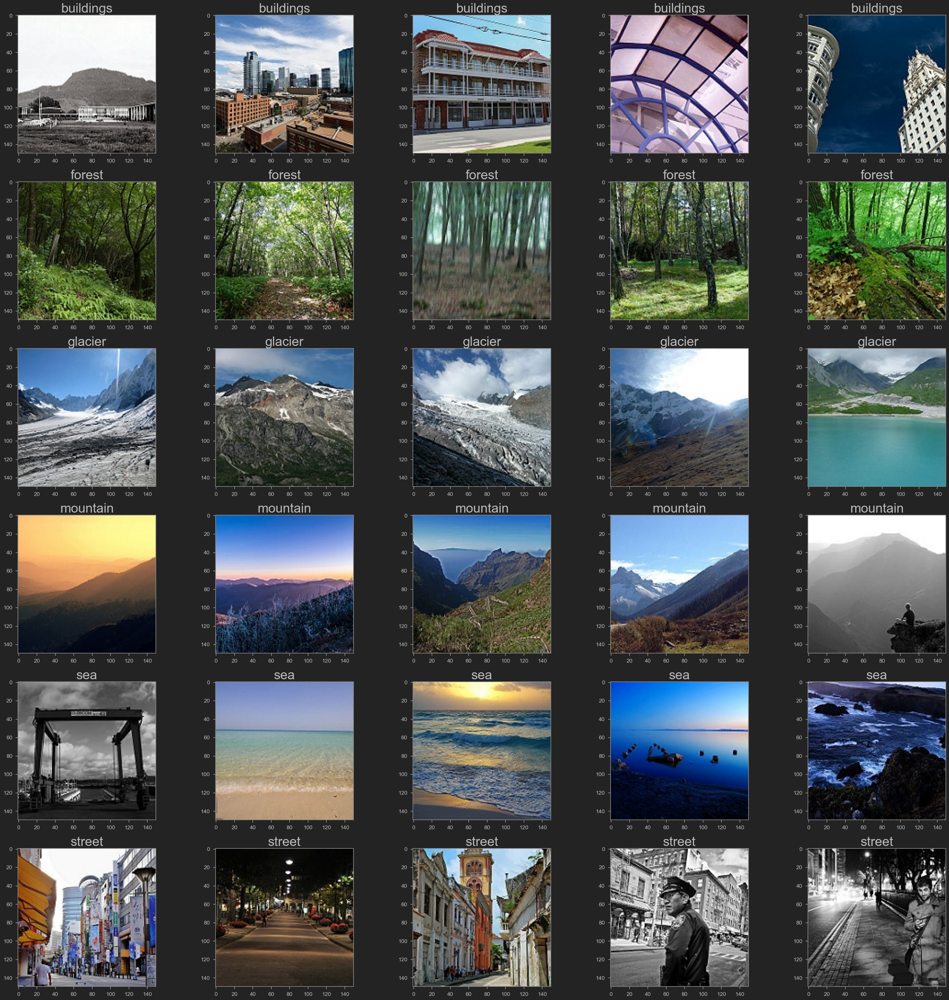

In [65]:
# Visualize the images in the dataset

fig, axs = plt.subplots(6,5, figsize=(32,32))
count = 0
for i in os.listdir('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train'):
  # get the list of images in the particular class
  train_class = os.listdir(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train',i))
  # plot 5 images per class
  for j in range(5):
    img = os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train',i,train_class[j])
    img = PIL.Image.open(img)
    axs[count][j].imshow(img)
    axs[count][j].set_title(i, fontsize = 30)

  count+=1
fig.tight_layout()

In [67]:
# Distribution of train images per class 
No_images_per_class = []
Class_name = []
for i in os.listdir('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train'):
  train_class = os.listdir(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_train', i))
  No_images_per_class.append(len(train_class))
  Class_name.append(i)
  print('Number of images in {} = {} \n'.format(i, len(train_class)))

Number of images in buildings = 2191 

Number of images in forest = 2271 

Number of images in glacier = 2404 

Number of images in mountain = 2512 

Number of images in sea = 2274 

Number of images in street = 2382 



### Number of images in buildings = 2191 
### Number of images in forest = 2271 
### Number of images in glacier = 2404 
### Number of images in mountain = 2512 
### Number of images in sea = 2274 
### Number of images in street = 2382

([<matplotlib.patches.Wedge at 0x2452321e2f0>,
 [Text(0.9703236975107998, 0.5181427622277184, 'buildings'),
  Text(0.08953270471012373, 1.0963502609965896, 'forest'),
  Text(-0.9042804215581987, 0.6263201411311364, 'glacier'),
  Text(-0.9681111230752618, -0.522265117902733, 'mountain'),
  Text(-0.005171028879415444, -1.0999878455966359, 'sea'),
  Text(0.9472897126855966, -0.5591441676705928, 'street')],
 [Text(0.5292674713695271, 0.2826233248514827, '15.6%'),
  Text(0.04883602075097657, 0.598009233270867, '16.2%'),
  Text(-0.4932438663044719, 0.3416291678897107, '17.1%'),
  Text(-0.5280606125865064, -0.2848718824923998, '17.9%'),
  Text(-0.002820561206953878, -0.5999933703254376, '16.2%'),
  Text(0.5167034796466891, -0.3049877278203233, '17.0%')])

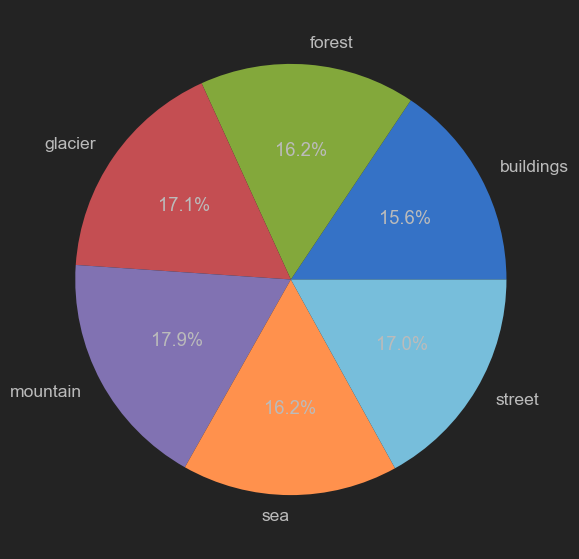

In [68]:
# A visual representaion of images per class
fig1, ax1 = plt.subplots()
ax1.pie(No_images_per_class,labels = Class_name, autopct = '%1.1f%%')

([<matplotlib.patches.Wedge at 0x24522b393f0>,
 [Text(0.9868146095771555, 0.48600095300841384, 'buildings'),
  Text(0.17435292970672123, 1.08609440469173, 'forest'),
  Text(-0.87268874746568, 0.6696374765847435, 'glacier'),
  Text(-0.9785334043640195, -0.5024662939379739, 'mountain'),
  Text(-0.013822517410649753, -1.0999131502134305, 'sea'),
  Text(0.9520515222950896, -0.550997185923488, 'street')],
 [Text(0.538262514314812, 0.26509142891368026, '14.6%'),
  Text(0.09510159802184794, 0.5924151298318526, '15.8%'),
  Text(-0.476012044072189, 0.36525680540986005, '18.4%'),
  Text(-0.5337454932894651, -0.2740725239661676, '17.5%'),
  Text(-0.007539554951263501, -0.5999526273891438, '17.0%'),
  Text(0.5193008303427761, -0.3005439195946298, '16.7%')])

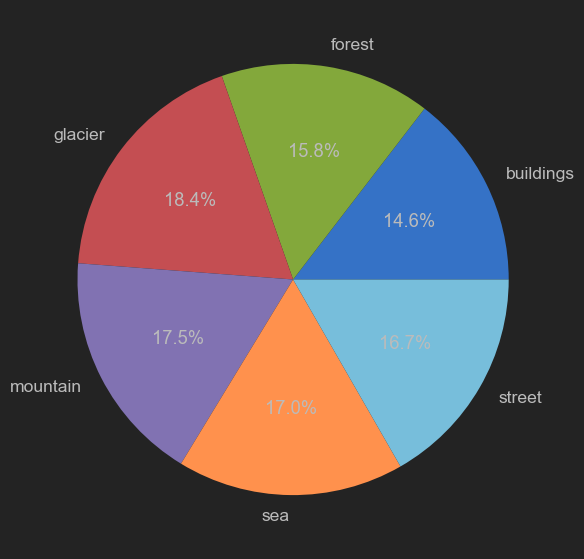

In [69]:
# For test dataset
# Distribution of testimages per class 
No_images_per_test_class = []
Class_name = []
for i in os.listdir('./scene_classification-20200625t182438z-001/Scene_Classification./seg_test'):
  test_class = os.listdir(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_test', i))
  No_images_per_test_class.append(len(test_class))
  Class_name.append(i)
  #print('Number of images in {} = {} \n'.format(i, len(test_class)))

fig2, ax2 = plt.subplots()
ax2.pie(No_images_per_test_class,labels = Class_name, autopct = '%1.1f%%')

# Data Augmentation & Data Generator

In [112]:
#creating training and validation dataset
train_path = "./scene_classification-20200625t182438z-001/Scene_Classification./seg_train"
train_ds = image_dataset_from_directory (
    train_path,
    label_mode = "categorical",
    validation_split = 0.2,
    subset = "training",
    image_size = (256,256),
    seed =42,
    shuffle =True,
    batch_size = 32,
    crop_to_aspect_ratio = True
)

valid_ds = image_dataset_from_directory (
    train_path,
    validation_split = 0.2,
    label_mode = "categorical",
    subset = "validation",
    image_size = (256,256),
    seed =42,
    shuffle =True,
    batch_size = 32,
    crop_to_aspect_ratio = True
)

Found 14034 files belonging to 6 classes.
Using 11228 files for training.
Found 14034 files belonging to 6 classes.
Using 2806 files for validation.


#creating Data Loaders for training, validation and test
train_generator = train_datagen.flow_from_directory(
        'scene_classification-20200625t182438z-001/Scene_Classification/seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='training')

validation_generator = train_datagen.flow_from_directory(
        'scene_classification-20200625t182438z-001/Scene_Classification/seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='validation')

test_generator = test_datagen.flow_from_directory(
        'scene_classification-20200625t182438z-001/Scene_Classification/seg_test',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical')

In [115]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 256, 256, 3)
(32, 6)


In [116]:
data_augmentation = tf.keras.Sequential([
  layers.Rescaling(1./255),
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
])

In [117]:
train_ds = train_ds.map(lambda x, y: (data_augmentation(x, training=True), y))

# Define the res_blocks and build the network

In [118]:
def res_block(X, filter, stage):
  
  # Convolutional_block
  X_copy = X

  f1 , f2, f3 = filter
    
  # Main Path
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_conv_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = MaxPool2D((2,2))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_a')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_conv_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_b')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_conv_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_c')(X)


  # Short path
  X_copy = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_conv_copy', kernel_initializer= glorot_uniform(seed = 0))(X_copy)
  X_copy = MaxPool2D((2,2))(X_copy)
  X_copy = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_copy')(X_copy)

  # ADD
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  # Identity Block 1
  X_copy = X


  # Main Path
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_identity_1_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_a')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_identity_1_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_b')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_identity_1_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_c')(X)

  # ADD
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  # Identity Block 2
  X_copy = X


  # Main Path
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_identity_2_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_a')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_identity_2_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_b')(X)
  X = Activation('relu')(X) 

  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_identity_2_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_c')(X)

  # ADD
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  return X


In [119]:
input_shape = (256,256,3)

# Input tensor shape
X_input = Input(input_shape)

# Zero-padding
X = ZeroPadding2D((3,3))(X_input)  #-> (262,262,3)

# 1 - stage
X = Conv2D(64, (7,7), strides= (2,2), name = 'conv1', kernel_initializer= glorot_uniform(seed = 0))(X) #-> (128,128,3)
X = BatchNormalization(axis =3, name = 'bn_conv1')(X)
X = Activation('relu')(X)
X = MaxPooling2D((3,3), strides= (2,2))(X) 

# 2- stage
X = res_block(X, filter= [64,64,256], stage= 2)

# 3- stage
X = res_block(X, filter= [128,128,512], stage= 3)

# 4- stage
X = res_block(X, filter= [256,256,1024], stage= 4)

# 5- stage
X = res_block(X, filter= [512,512,2048], stage= 5)

# Average Pooling
X = AveragePooling2D((2,2), name = 'Averagea_Pooling')(X)

# Final layer
X = Flatten()(X)
X = Dropout(0.4)(X)
X = Dense(6, activation = 'softmax', name = 'Dense_final', kernel_initializer= glorot_uniform(seed=0))(X)


model = Model( inputs= X_input, outputs = X, name = 'Resnet18')

model.summary()

Model: "Resnet18"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 zero_padding2d_8 (ZeroPadd  (None, 262, 262, 3)          0         ['input_9[0][0]']             
 ing2D)                                                                                           
                                                                                                  
 conv1 (Conv2D)              (None, 128, 128, 64)         9472      ['zero_padding2d_8[0][0]']    
                                                                                                  
 bn_conv1 (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1[0][0]']        

# Compile and Train the network

In [120]:
model.compile(optimizer='adam', loss= tf.keras.losses.CategoricalCrossentropy() ,metrics = ['accuracy'])

In [121]:
# Early Stopping 
my_callbacks = [ EarlyStopping(monitor='val_loss',mode='min',verbose=1,patience=15),

#save the model with least validation loss
 ModelCheckpoint(filepath= "rsnet18_weights.hd5", verbose=1, save_best_only=True)
]

In [122]:
history = model.fit(
    train_ds,
    validation_data = valid_ds,
    epochs = 3,
    callbacks = my_callbacks
)

Epoch 1/3
351/351 [==============================] - ETA: 0s - loss: 1.6141 - accuracy: 0.4505
Epoch 1: val_loss improved from inf to 3503.33423, saving model to rsnet18_weights.hd5
INFO:tensorflow:Assets written to: rsnet18_weights.hd5\assets


INFO:tensorflow:Assets written to: rsnet18_weights.hd5\assets


351/351 [==============================] - 1328s 4s/step - loss: 1.6141 - accuracy: 0.4505 - val_loss: 3503.3342 - val_accuracy: 0.1532
Epoch 2/3
351/351 [==============================] - ETA: 0s - loss: 1.1443 - accuracy: 0.5576
Epoch 2: val_loss improved from 3503.33423 to 2740.95850, saving model to rsnet18_weights.hd5
INFO:tensorflow:Assets written to: rsnet18_weights.hd5\assets


INFO:tensorflow:Assets written to: rsnet18_weights.hd5\assets


351/351 [==============================] - 1276s 4s/step - loss: 1.1443 - accuracy: 0.5576 - val_loss: 2740.9585 - val_accuracy: 0.1832
Epoch 3/3
351/351 [==============================] - ETA: 0s - loss: 1.0274 - accuracy: 0.6082
Epoch 3: val_loss did not improve from 2740.95850
351/351 [==============================] - 1278s 4s/step - loss: 1.0274 - accuracy: 0.6082 - val_loss: 2778.4810 - val_accuracy: 0.1532


# Model Evaluation

In [126]:
# Loading the model trained on Colab
model.load_weights('./scene_classification-20200625t182438z-001/Scene_Classification./weights.hdf5')

In [128]:
test_path = './scene_classification-20200625t182438z-001/Scene_Classification./seg_test'
test_ds = image_dataset_from_directory (
    test_path,
    label_mode = "categorical",
    image_size = (256,256),
    seed =42,
    shuffle =True,
    batch_size = 32,
    crop_to_aspect_ratio = True
)

Found 3000 files belonging to 6 classes.


In [157]:
for element in test_ds.as_numpy_iterator():
    print(element[1])
    break

[[0. 1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0.]
 [0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1.]]


In [158]:
test_rescale = tf.keras.layers.Rescaling(1./255)

In [159]:
test_ds = test_ds.map(lambda x, y: (test_rescale (x, training=True), y))

In [160]:
evaluate = model.evaluate(test_ds, verbose= 1)

94/94 [==============================] - 58s 613ms/step - loss: 0.3952 - accuracy: 0.8487


In [208]:
root_folder = './scene_classification-20200625t182438z-001/Scene_Classification./seg_test' 
label_names = {}

# List the subfolders in the root folder
subfolders = [f for f in os.listdir(root_folder) if os.path.isdir(os.path.join(root_folder, f))]

# Create a dictionary to map numeric labels to folder names
for i, folder_name in enumerate(subfolders):
    label_names[i] = folder_name

print(label_names)
label_list = list(label_names.values())
print(label_list)

{0: 'buildings', 1: 'forest', 2: 'glacier', 3: 'mountain', 4: 'sea', 5: 'street'}
['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']


In [201]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score,ConfusionMatrixDisplay

In [188]:
prediction = []
original = []
image = []
count = 0
for i in os.listdir('./scene_classification-20200625t182438z-001/Scene_Classification./seg_test'):
  for item in os.listdir(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification/seg_test', i)):
    # code to open the image
    img= PIL.Image.open(os.path.join('./scene_classification-20200625t182438z-001/Scene_Classification./seg_test', i, item))
    # resizing the image to (256,256)
    img = img.resize((256, 256))
    # appending image to the image list
    image.append(img)
    # converting image to array
    img = np.asarray(img, dtype = np.float32)
    # normalizing the image
    img = img / 255
    # reshaping the image into a 4D array
    img = img.reshape(-1, 256, 256, 3)
    # making prediction of the model
    predict = model.predict(img)
    # getting the index corresponding to the highest value in the prediction
    predict = np.argmax(predict)
    # appending the predicted class to the list
    prediction.append(label_names[predict])
    # appending original class to the list
    original.append(i)


1/1 [==============================] - 0s 336ms/step


In [182]:
predicted_class = []
for array in prediction:
    label_index = np.where(array == 1.0)[0][0]
    predicted_class.append(label_names[label_index])
    


In [183]:
predicted_class[0]

'forest'

In [191]:
score = accuracy_score(original, prediction)
print("Test Accuracy : {}".format(score))

Test Accuracy : 0.8616666666666667


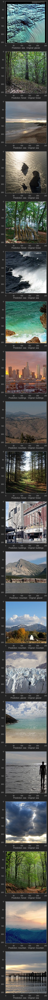

In [193]:
# visualize the results
import random
fig = plt.figure(figsize = (100,100))
for i in range(20):
    j = random.randint(0, len(image))
    fig.add_subplot(20, 1, i+1)
    plt.xlabel("Prediction: " + prediction[j] +"   Original: " + original[j])
    plt.imshow(image[j])
fig.tight_layout()
plt.show()

In [203]:
print(classification_report(np.asarray(prediction),np.asarray(original)))

              precision    recall  f1-score   support

   buildings       0.92      0.84      0.87       478
      forest       0.96      0.95      0.96       480
     glacier       0.69      0.88      0.77       434
    mountain       0.93      0.72      0.81       676
         sea       0.87      0.92      0.89       479
      street       0.83      0.92      0.88       453

    accuracy                           0.86      3000
   macro avg       0.87      0.87      0.86      3000
weighted avg       0.87      0.86      0.86      3000



<Figure size 2000x2000 with 0 Axes>

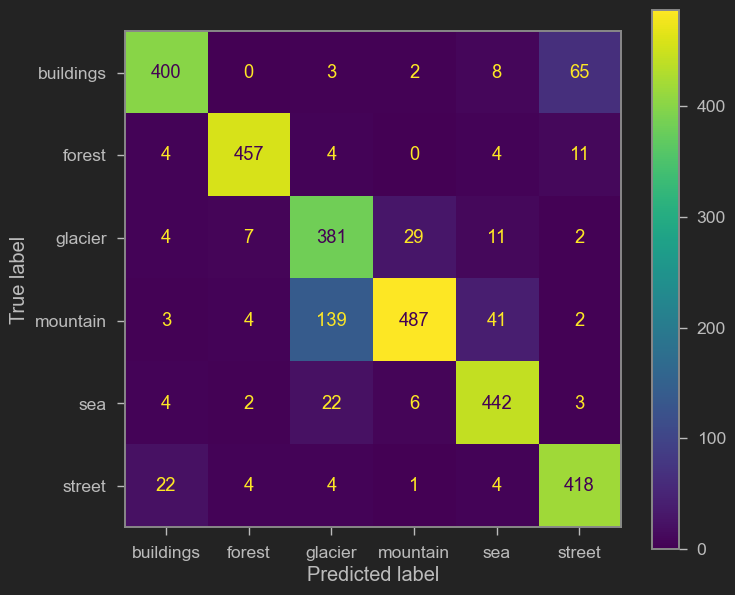

In [210]:
plt.figure(figsize=(20,20))
cm = confusion_matrix(np.asarray(prediction),np.asarray(original), labels=label_list)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_list)
disp.plot()
plt.show()


# Visulaizing Grad Cam

In [213]:
def grad_cam(img):
 # Convert the image to array of type float32
  img = np.asarray(img, dtype = np.float32)

  # Reshape the image from (256,256,3) to (1,256,256,3)
  img = img.reshape(-1, 256, 256, 3)
  img_scaled = img / 255

  # Name of the average pooling layer and dense final (you can see these names in the model summary)
  classification_layers = ["Averagea_Pooling", "Dense_final"]

  # Last convolutional layer in the model
  final_conv = model.get_layer("res_5_identity_2_c")

  # Create a model with original model inputs and the last conv_layer as the output
  final_conv_model = keras.Model(model.inputs, final_conv.output)

  # Then we create the input for classification layer, which is the output of last conv layer
  # In our case, output produced by the conv layer is of the shape (1,3,3,2048) 
  # Since the classification input needs the features as input, we ignore the batch dimension

  classification_input = keras.Input(shape = final_conv.output.shape[1:])

  # We iterate through the classification layers, to get the final layer and then append 
  # the layer as the output layer to the classification model.
  temp = classification_input
  for layer in classification_layers:
      temp = model.get_layer(layer)(temp)
  classification_model = keras.Model(classification_input, temp)


  # We use gradient tape to monitor the 'final_conv_output' to retrive the gradients
  # corresponding to the predicted class
  with tf.GradientTape() as tape:
      # Pass the image through the base model and get the feature map 
      final_conv_output = final_conv_model(img_scaled)

      # Assign gradient tape to monitor the conv_output
      tape.watch(final_conv_output)
      
      # Pass the feature map through the classification model and use argmax to get the 
      # index of the predicted class and then use the index to get the value produced by final
      # layer for that class
      prediction = classification_model(final_conv_output)

      predicted_class = tf.argmax(prediction[0][0][0])

      predicted_class_value = prediction[:,:,:,predicted_class]
  
  # Get the gradient corresponding to the predicted class based on feature map.
  # which is of shape (1,3,3,2048)
  gradient = tape.gradient(predicted_class_value, final_conv_output)

  # Since we need the filter values (2048), we reduce the other dimensions, 
  # which would result in a shape of (2048,)
  gradient_channels = tf.reduce_mean(gradient, axis=(0, 1, 2))

  # We then convert the feature map produced by last conv layer(1,6,6,1536) to (6,6,1536)
  final_conv_output = final_conv_output.numpy()[0]

  gradient_channels = gradient_channels.numpy()

  # We multiply the filters in the feature map produced by final conv layer by the 
  # filter values that are used to get the predicted class. By doing this we inrease the
  # value of areas that helped in making the prediction and lower the vlaue of areas, that 
  # did not contribute towards the final prediction
  for i in range(gradient_channels.shape[-1]):
      final_conv_output[:, :, i] *= gradient_channels[i]

  # We take the mean accross the channels to get the feature map
  heatmap = np.mean(final_conv_output, axis=-1)

  # Normalizing the heat map between 0 and 1, to visualize it
  heatmap_normalized = np.maximum(heatmap, 0) / np.max(heatmap)

  # Rescaling and converting the type to int
  heatmap = np.uint8(255 * heatmap_normalized )

  # Create the colormap
  color_map = plt.cm.get_cmap('jet')

  # get only the rb features from the heatmap
  color_map = color_map(np.arange(256))[:, :3]
  heatmap = color_map[heatmap]

  # convert the array to image, resize the image and then convert to array
  heatmap = keras.preprocessing.image.array_to_img(heatmap)
  heatmap = heatmap.resize((256, 256))
  heatmap = np.asarray(heatmap, dtype = np.float32)

  # Add the heatmap on top of the original image
  final_img = heatmap * 0.4 + img[0]
  final_img = keras.preprocessing.image.array_to_img(final_img)

  return final_img, heatmap_normalized

C:\Users\91895\AppData\Local\Temp\ipykernel_46900\1486936609.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('jet')


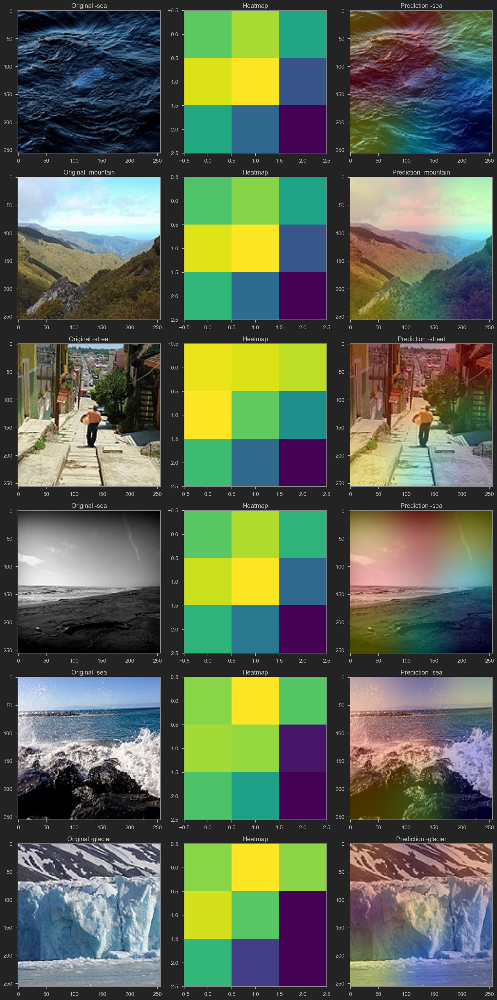

In [214]:
import random
fig, axs = plt.subplots(6,3, figsize = (16,32))
count = 0
for _ in range(6):
  i = random.randint(0, len(image))
  gradcam, heatmap = grad_cam(image[i])
  axs[count][0].title.set_text("Original -" + original[i])
  axs[count][0].imshow(image[i])
  axs[count][1].title.set_text("Heatmap") 
  axs[count][1].imshow(heatmap)
  axs[count][2].title.set_text("Prediction -" + prediction[i]) 
  axs[count][2].imshow(gradcam)  
  count += 1

fig.tight_layout()